Importing the libraries

In [ ]:
import numpy as np
from PIL import Image

In [ ]:
!pip install diffusers
!pip install transformers
!pip install accelerate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 989.1/989.1 kB 7.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 14.0 MB/s eta 0:00:00
  Created wheel for diffusers: filename=diffusers-0.20.2-py3-none-any.whl size=1342633 sha256=3e2e7ba705a18aaa1d3bc8a430752bbe953fa9dcddb2e225815deb2caa481b4c
  Stored in directory: /root/.cache/pip/wheels/dc/8b/d9/34f7a1936109e05e9bba0cc2241a6f8cd89e25959dc7aae942
Successfully built diffusers
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 45.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 4.4 MB/s eta 0:00:00


In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import requests
from PIL import Image
from io import BytesIO

In [ ]:
import torch
from diffusers import StableDiffusionInpaintPipeline

Getting the Image url and then saving the image

In [ ]:
img_url = 'https://i.pinimg.com/1200x/e8/5f/31/e85f3181117bbd44b103aff25f7a98e0.jpg'
img_name = img_url.split('/')[-1]
img_name

'e85f3181117bbd44b103aff25f7a98e0.jpg'

In [ ]:
r = requests.get(img_url)
img = Image.open(BytesIO(r.content))
img.save('sample_data/'+ img_name, format = 'jpeg')

In [ ]:
#picture of another horse
img_url2 = 'https://i.pinimg.com/originals/71/68/87/7168875e8f6a2d134fdde313b2614457.jpg'
img_name2 = img_url2.split('/')[-1]
img_name2

'7168875e8f6a2d134fdde313b2614457.jpg'

In [ ]:
r2 = requests.get(img_url2)
img2 = Image.open(BytesIO(r2.content))
img2.save('sample_data/'+ img_name2, format = 'jpeg')

In [ ]:
img_path = "/content/sample_data/girl_revised.png"
img = cv2.imread(img_path) #Reading image
print(img.shape)

img_path2 = "/content/sample_data/img2.png"
img2 = cv2.imread(img_path2) #Reading image
print(img2.shape)

(1520, 1000, 3)
(1520, 1000, 3)


In [ ]:
h, w, c = img2.shape

Defining the function to generate a gradient image

In [ ]:
def get_gradient_2d(start, stop, width, height, is_horizontal):
    if is_horizontal:
        return np.tile(np.linspace(start, stop, width), (height, 1))
    else:
        return np.tile(np.linspace(start, stop, height), (width, 1)).T

In [ ]:
def get_gradient_3d(width, height, start_list, stop_list, is_horizontal_list):
    result = np.zeros((height, width, len(start_list)), dtype=np.float)

    for i, (start, stop, is_horizontal) in enumerate(zip(start_list, stop_list, is_horizontal_list)):
        result[:, :, i] = get_gradient_2d(start, stop, width, height, is_horizontal)

    return result

<ipython-input-8-9f3fb224e2af>:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  result = np.zeros((height, width, len(start_list)), dtype=np.float)


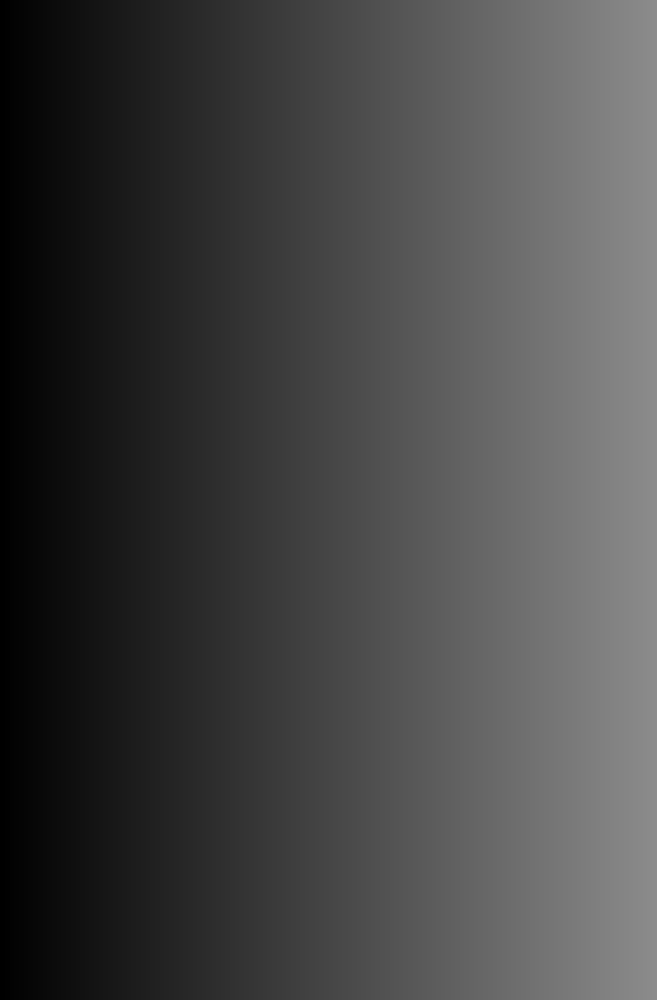

In [ ]:
array = get_gradient_3d(w, h,(0, 0, 0),(140, 140, 140), (True, True, True))
I1 = Image.fromarray(np.uint8(array))
I1

<ipython-input-8-9f3fb224e2af>:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  result = np.zeros((height, width, len(start_list)), dtype=np.float)


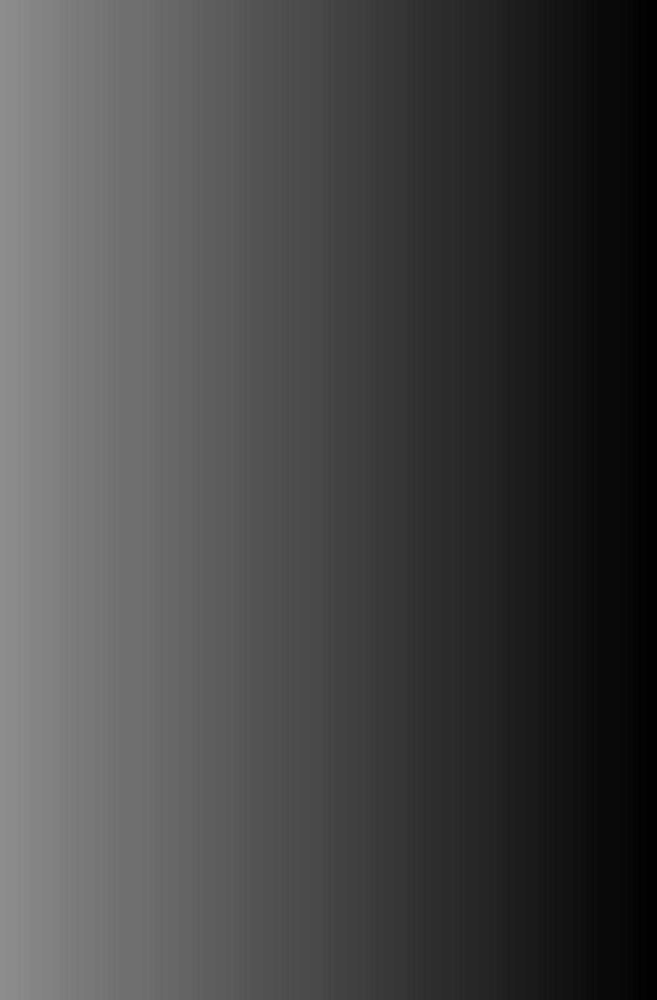

In [ ]:
array = get_gradient_3d(w, h, (140, 140, 140), (0, 0, 0), (True, True, True))
I2 = Image.fromarray(np.uint8(array))
I2

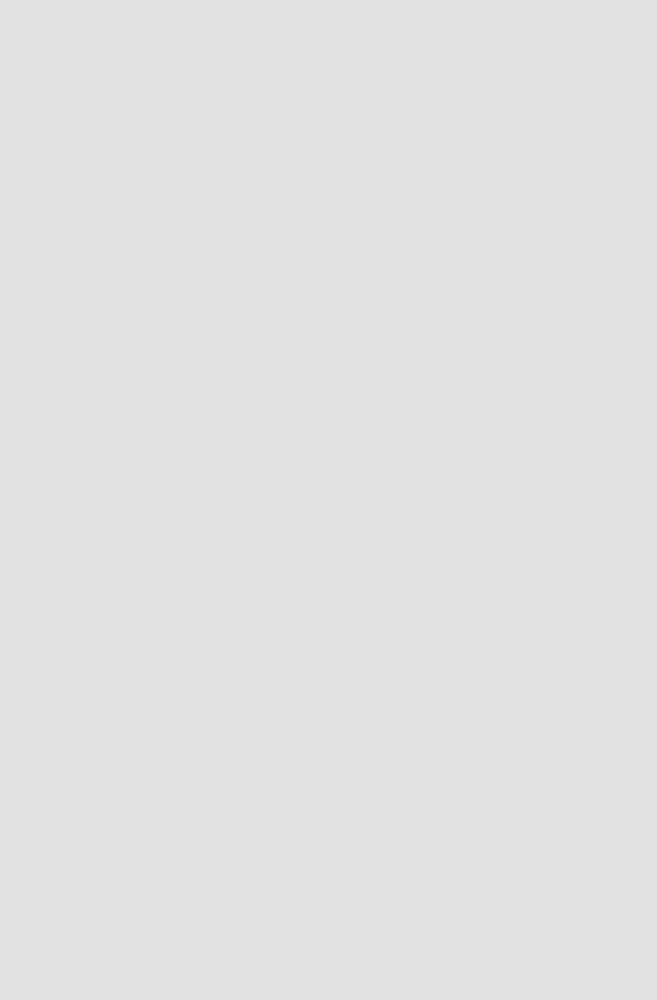

In [ ]:
#creating white image
imgWhite = 225*(np.ones((h,w), np.uint8))
imgWhite = cv2.cvtColor(imgWhite, cv2.COLOR_GRAY2BGR)
cv2_imshow(imgWhite)

Stacking the gradient images and grey image together

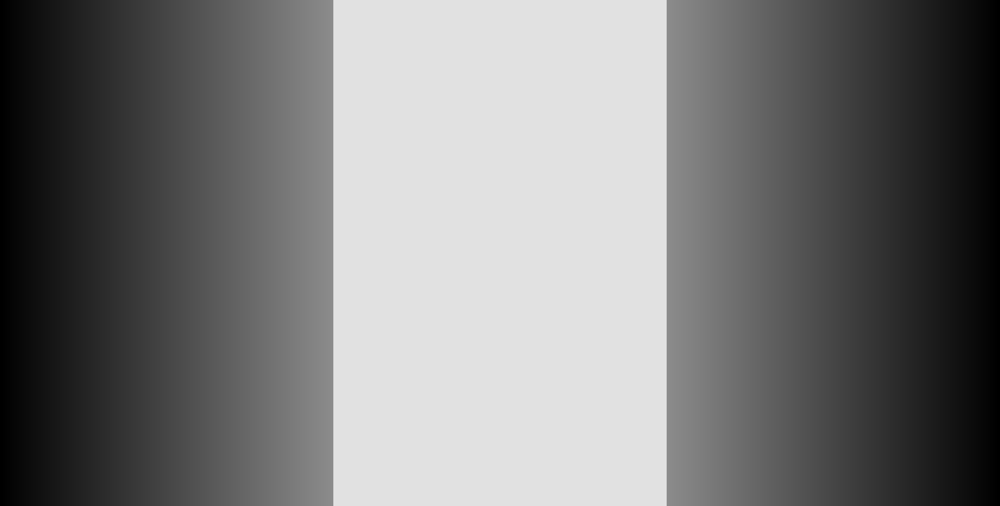

In [ ]:
#stacking the masked images together
masked = np.hstack((I1,imgWhite, I2))
cv2_imshow(masked)

In [ ]:
type(I1)

PIL.Image.Image

In [ ]:
type(I2)

PIL.Image.Image

In [ ]:
cv2_imshow(img)

In [ ]:
cv2_imshow(img2)

In [ ]:
cv2_imshow(img)

In [ ]:
cv2_imshow(img2)

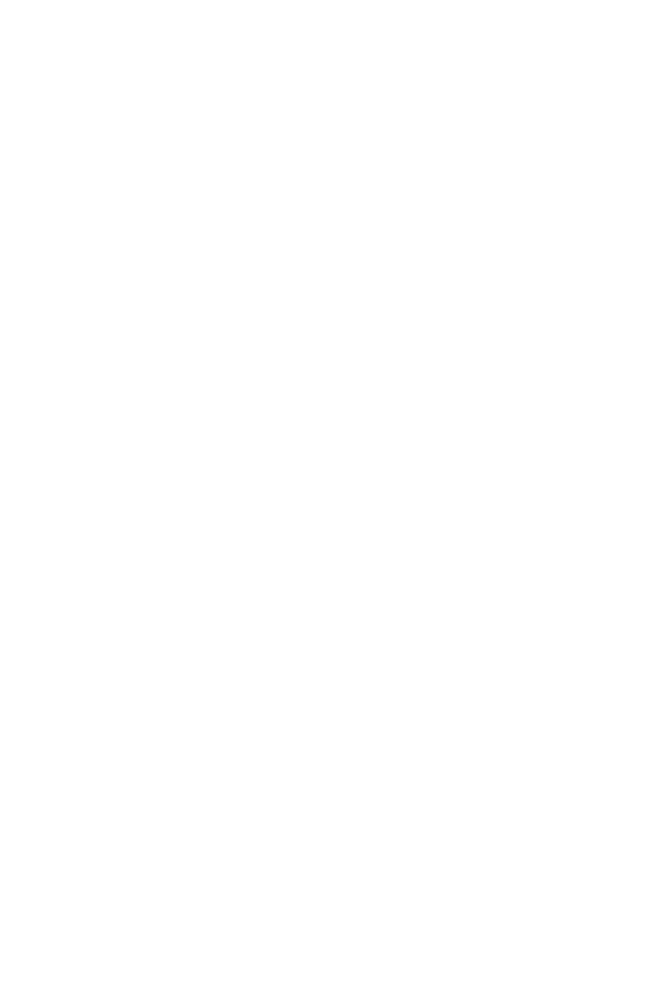

In [ ]:
#creating white image
imgWhite1 = 255*(np.ones((h,w), np.uint8))
imgWhite1 = cv2.cvtColor(imgWhite1, cv2.COLOR_GRAY2BGR)
cv2_imshow(imgWhite1)

Stacking the images and white images together

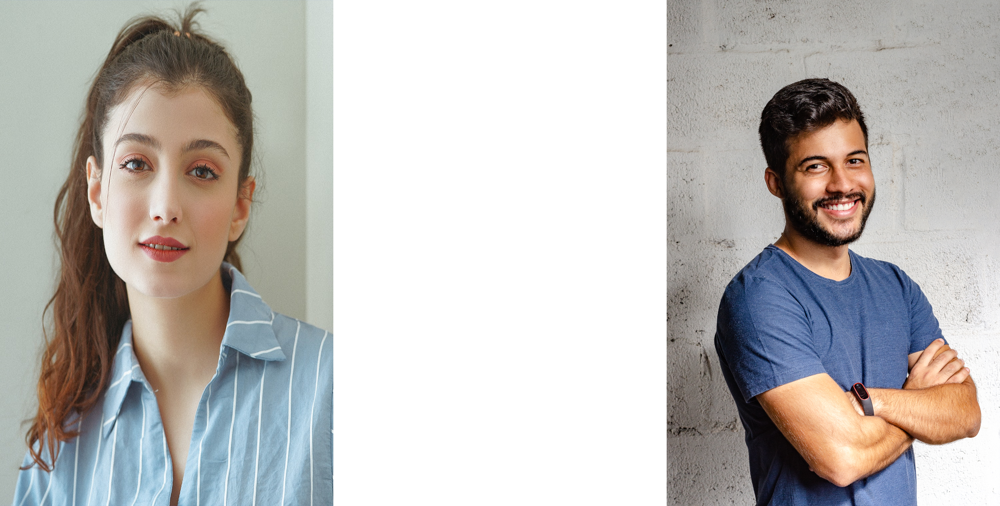

In [ ]:
#stacking the images and white image together
stacked = np.hstack((img, imgWhite1, img2))
cv2_imshow(stacked)

In [ ]:
height, width, channels = stacked.shape

In [ ]:
height

1520

In [ ]:
width

3000

Resizing the input image and the masked image

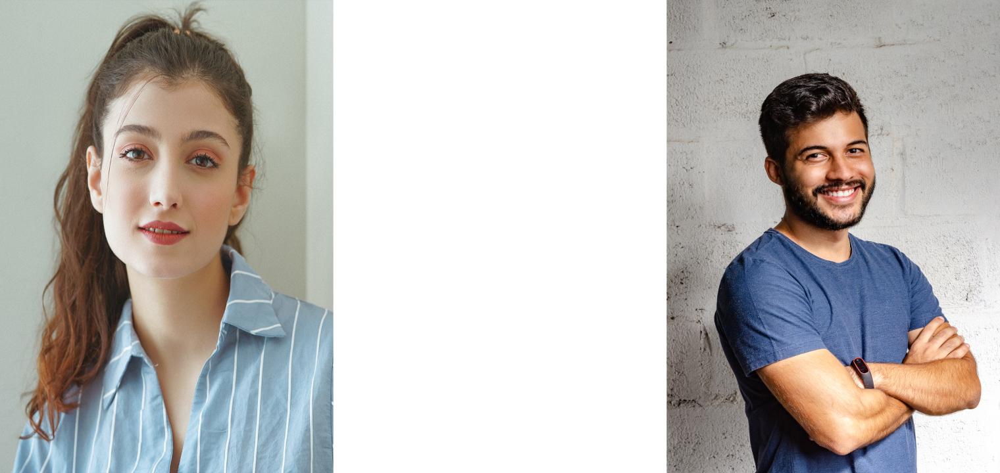

In [ ]:
stacked2 = cv2.resize(stacked, (1520, 720), interpolation= cv2.INTER_AREA)  #, None, scale, scale)
stacked2.shape
cv2_imshow(stacked2)

In [ ]:
masked.shape

In [ ]:
type(masked)

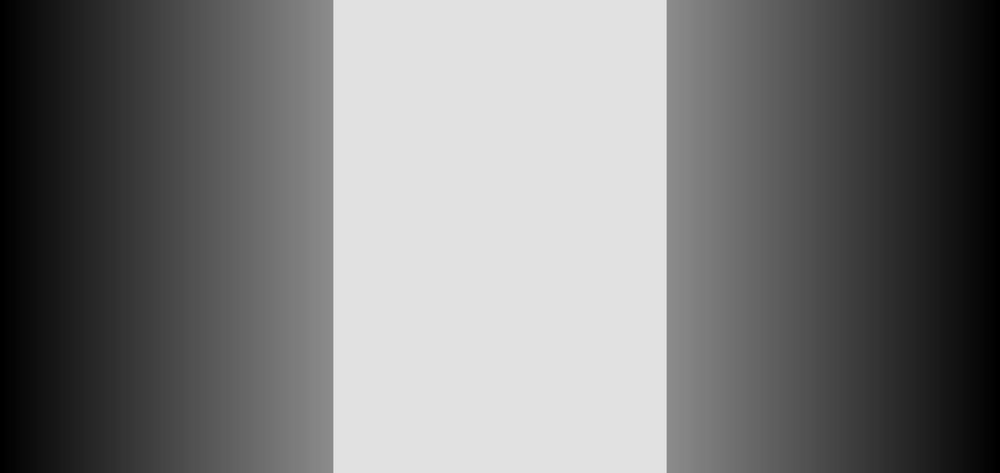

In [ ]:
masked2 = cv2.resize(masked, (1520, 720), interpolation= cv2.INTER_AREA)  #, None, scale, scale)
masked2.shape
cv2_imshow(masked2)

Converting the original image and the masked image from array to PIL image to send them to the model

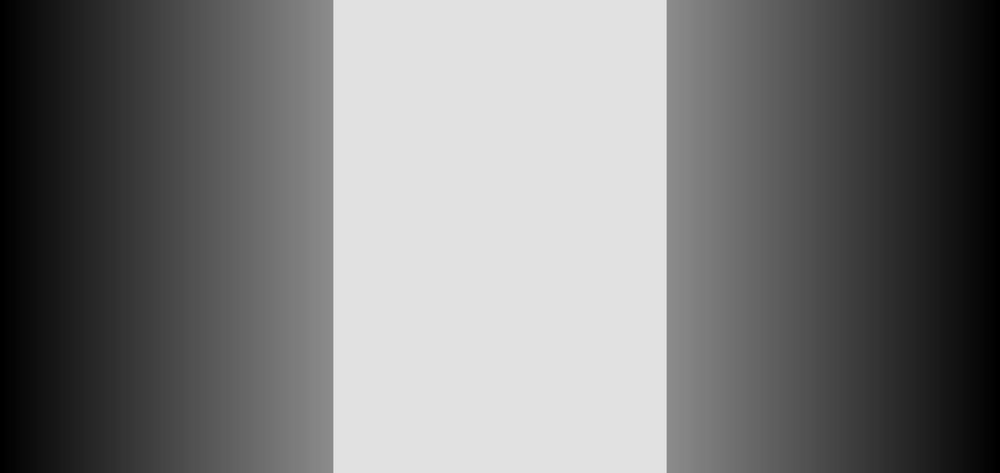

In [ ]:
masked2 = Image.fromarray(masked2)
masked2

In [ ]:
type(masked2)

PIL.Image.Image

In [ ]:
type(stacked2)

numpy.ndarray

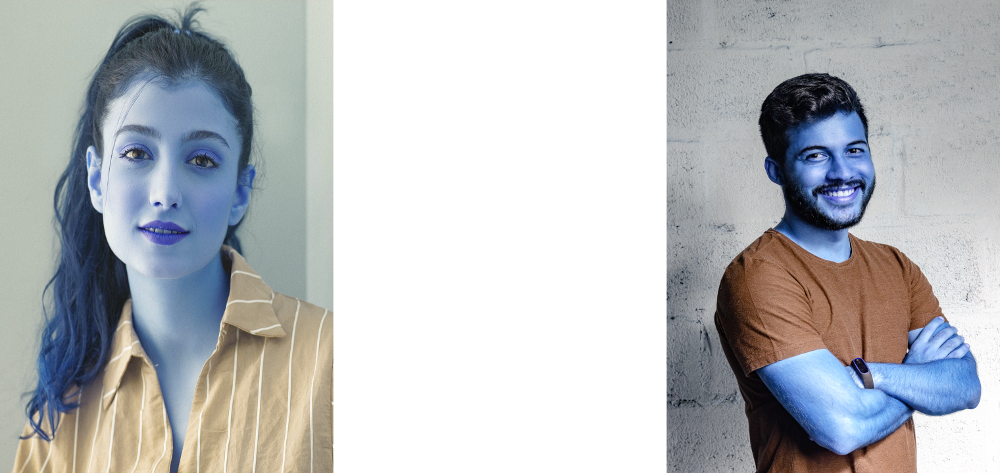

In [ ]:
#converting the array image stacked to PIL
stacked2 = Image.fromarray(stacked2)
stacked2

In [ ]:
type(stacked2)

PIL.Image.Image

In [ ]:
stacked2.size

(1520, 720)

In [ ]:
masked2.size

(1520, 720)

In [ ]:
from diffusers import DiffusionPipeline, EulerDiscreteScheduler, DPMSolverMultistepScheduler, LMSDiscreteScheduler

In [ ]:
scheduler = DPMSolverMultistepScheduler.from_pretrained("stabilityai/stable-diffusion-2-inpainting", subfolder="scheduler")

Defining the pipeline of the model

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

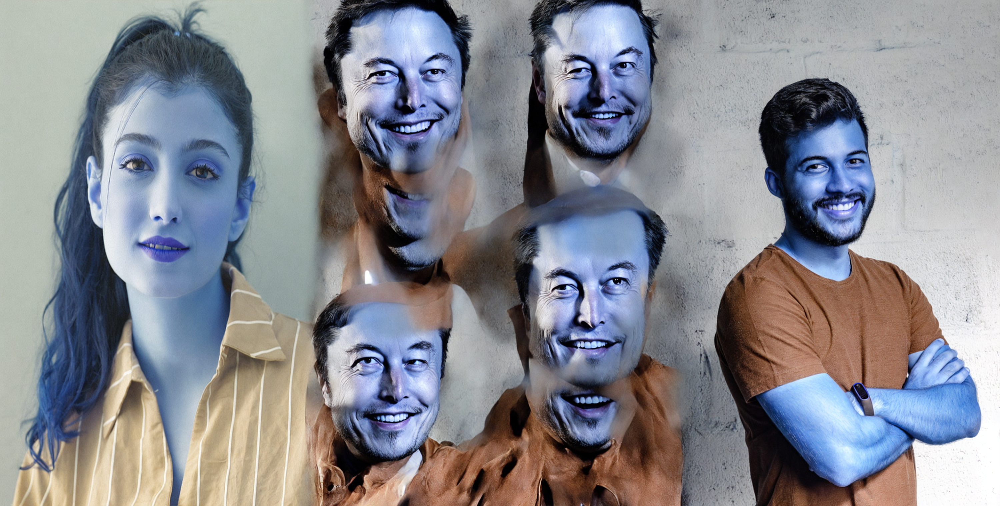

In [ ]:
pipe = StableDiffusionInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-2-inpainting", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

prompt = "Elon Musk standing and smiling and waving, high resolution"
image = pipe(prompt=prompt, image=stacked2, mask_image=masked2, num_inference_steps=50,
                        guidance_scale=8.5,
                        num_images_per_prompt=1, output_type = "pil",
                        negative_prompt="Broken anatomy, Mutation, half body parts, two faces,more than two faces, distorted face",
              height = height, width = width).images[0]
image

In [ ]:
pipe.scheduler.compatibles

[diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDP

Converting the PIL image back to numpy array

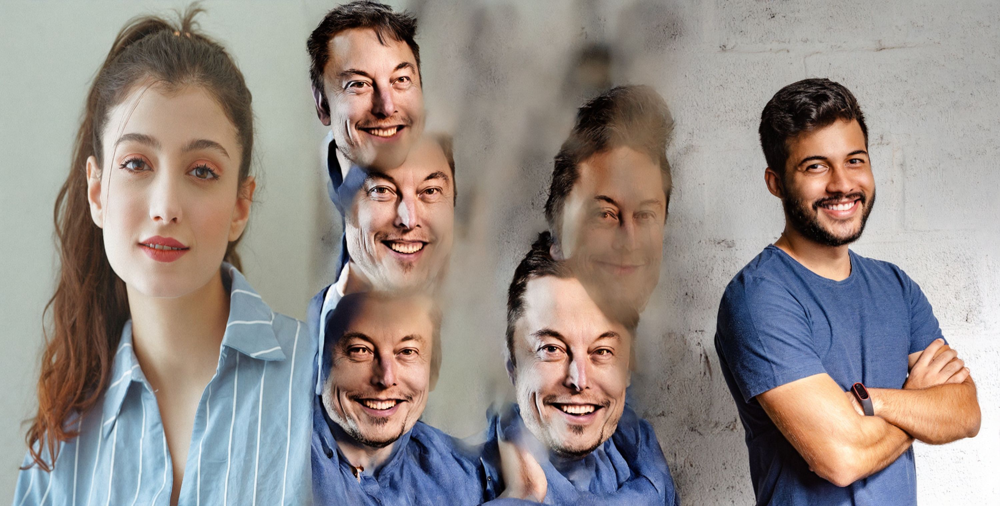

In [ ]:
#converting the PIL image back to numpy array image
img3 = np.array(image)
cv2_imshow(img3)

In [ ]:
result = cv2.resize(img3,(width, height))
cv2_imshow(result)